In [ ]:
import numpy as np
import pandas as pd

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
def Upload_csv(filePath, encoding):
  data = pd.read_csv(filePath, encoding=encoding)
  return data

filePath = input("Upload File ")
encoding = 'UTF-8'
data = Upload_csv(filePath, encoding)
df = pd.DataFrame(data)

Upload File /content/drive/MyDrive/Malaria/MALARIA.csv


In [ ]:
df['plat'].unique()

array(['32.271198', '33.077878\t', '29.505504', ..., '32.082142',
       '31.8326794', '31.820567'], dtype=object)

In [ ]:
df.head()

,id,date,chiefcomplaint,provisionaldiagnose,patient_id,hospital,district,pdistrict,pgender,ptown,plat,plong,puc,age,province,street,houseno,phasno,facility_type
0,1322,06/22/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Bhalwal,Sargodha,Sargodha,male,Bhalwal,32.271198,72.901154,-select-,0.0,Punjab,NaN,NaN,2015,NaN
1,1326,06/22/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Bhalwal,Sargodha,Sargodha,male,Bhalwal,32.271198,72.901154,-select-,0.0,Punjab,NaN,NaN,2015,NaN
2,1331,06/22/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Bhalwal,Sargodha,Sargodha,female,Bhalwal,32.271198,72.901154,-select-,0.0,Punjab,NaN,NaN,2015,NaN
3,1650,06/23/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Sohawa,Jhelum,Jhelum,male,-select-,33.077878\t,73.449612,NaN,4.0,Punjab,NaN,NaN,2015,NaN
4,1929,06/25/2015,NaN,MALARIA (SUSPECTED),NaN,GOVT.FATIMA JINNAH WOMEN HOSP. MULTAN (SS),Multan,Multan,female,Jalalpur Pirwala,29.505504,71.217299,Other,28.0,Punjab,NaN,NaN,2015,NaN


In [ ]:
df.shape

(18861, 19)

In [ ]:
df.dtypes

id                       int64
date                    object
chiefcomplaint         float64
provisionaldiagnose     object
patient_id             float64
hospital                object
district                object
pdistrict               object
pgender                 object
ptown                   object
plat                    object
plong                   object
puc                     object
age                    float64
province                object
street                  object
houseno                 object
phasno                   int64
facility_type           object
dtype: object

In [ ]:
def Total_null_each_column():
  totalnull_ec = df.isnull().sum()
  return totalnull_ec

In [ ]:
Total_null_each_column()

id                         0
date                       0
chiefcomplaint         16355
provisionaldiagnose        0
patient_id             16355
hospital                   0
district                   0
pdistrict                  0
pgender                  204
ptown                    239
plat                     127
plong                    133
puc                     4235
age                        7
province               14793
street                 16202
houseno                16225
phasno                     0
facility_type             69
dtype: int64

In [ ]:
def extract_lat_lon(coord):
    import re
    pattern = r'\s*(-?\d+\.\d+)\s*,\s*(-?\d+\.\d+)\s*'
    matches = re.findall(pattern, coord)
    if matches:
        return float(matches[0])
    return None


In [ ]:
# Apply the function to both latitude and longitude columns
df[['plat', 'plong']] = df[['plat', 'plong']].applymap(extract_lat_lon)

TypeError: ignored

In [ ]:
def Extract_latlong_float_converted(latitude, longitude):
  df[[latitude,longitude]] = (df[[latitude,longitude]].apply(lambda x: x.str.extract(r'\s*(-?\d+\.\d+)\s*,\s*(-?\d+\.\d+)\s*', expand=False).astype(float)))

Extracting only charachters that we want.
Using `Series.str.extract` and chain `Series.astype` to set the dtype to float afterwards.

In [ ]:
Extract_latlong_float_converted('plat', 'plong')

ValueError: ignored

In [ ]:
df[df['plat'].notnull() & df['plong'].notnull()]

,id,date,chiefcomplaint,provisionaldiagnose,patient_id,hospital,district,pdistrict,pgender,ptown,plat,plong,puc,age,province,street,houseno,phasno,facility_type
0,1322,06/22/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Bhalwal,Sargodha,Sargodha,male,Bhalwal,32.271198,72.901154,-select-,0.0,Punjab,NaN,NaN,2015,NaN
1,1326,06/22/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Bhalwal,Sargodha,Sargodha,male,Bhalwal,32.271198,72.901154,-select-,0.0,Punjab,NaN,NaN,2015,NaN
2,1331,06/22/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Bhalwal,Sargodha,Sargodha,female,Bhalwal,32.271198,72.901154,-select-,0.0,Punjab,NaN,NaN,2015,NaN
3,1650,06/23/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Sohawa,Jhelum,Jhelum,male,-select-,33.077878,73.449612,NaN,4.0,Punjab,NaN,NaN,2015,NaN
4,1929,06/25/2015,NaN,MALARIA (SUSPECTED),NaN,GOVT.FATIMA JINNAH WOMEN HOSP. MULTAN (SS),Multan,Multan,female,Jalalpur Pirwala,29.505504,71.217299,Other,28.0,Punjab,NaN,NaN,2015,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18851,7348460,24-10-2018,NaN,MALARIA (SUSPECTED),NaN,THQ HOSPITAL QAIDABAD,Khushab,Khushab,male,Qaidabad,32.338517,71.877438,-select-,68.0,NaN,NaN,NaN,2018,THQ
18852,7352735,25-10-2018,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital PD Khan,Jhelum,Jhelum,female,Pind Dadan Khan,32.623473,73.089159,-select-,34.0,NaN,NaN,NaN,2018,THQ
18853,7406867,17-03-2019,NaN,"MALARIA (SUSPECTED), MENINGITIS (SUSPTECTED), ...",NaN,DHQ Hospital Hafizabad,Hafizabad,Hafizabad,female,Hafizabad,32.082142,73.672939,-select-,85.0,Punjab,NaN,NaN,2019,DHQ
18854,7390465,06-01-2019,NaN,MALARIA (SUSPECTED),NaN,THQ Lalian,Chiniot,Chiniot,male,Lalian,31.832679,72.799920,Other,18.0,Punjab,NaN,NaN,2019,THQ


In [ ]:
df[df['plat'].isnull() & df['plong'].isnull()]

,id,date,chiefcomplaint,provisionaldiagnose,patient_id,hospital,district,pdistrict,pgender,ptown,plat,plong,puc,age,province,street,houseno,phasno,facility_type
61,39931,08/17/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Hasilpur,Bahawalpur,Bahawalpur,male,Hasilpur,NaN,NaN,-select-,75.0,NaN,NaN,NaN,2015,THQ
67,42138,08/18/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Hasilpur,Bahawalpur,Bahawalpur,male,Hasilpur,NaN,NaN,-select-,35.0,NaN,NaN,NaN,2015,THQ
94,47083,08/20/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Khairpur Tamewali,Bahawalpur,Bahawalpur,male,Khairpur Tamewali,NaN,NaN,-select-,35.0,Punjab,NaN,NaN,2015,THQ
97,47523,08/21/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Hasilpur,Bahawalpur,Bahawalpur,female,Hasilpur,NaN,NaN,-select-,21.0,NaN,NaN,NaN,2015,THQ
98,47566,08/21/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Hasilpur,Bahawalpur,Bahawalpur,male,Khairpur Tamewali,NaN,NaN,-select-,22.0,NaN,NaN,NaN,2015,THQ
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18856,7406986,11-03-2019,NaN,MALARIA (SUSPECTED),NaN,DHQ Hospital Attock,Attock,Attock,male,Attock,NaN,NaN,Other,0.0,Punjab,NaN,NaN,2019,DHQ
18857,7407146,11-03-2019,NaN,MALARIA (SUSPECTED),NaN,DHQ Hospital Attock,Attock,Attock,male,Attock,NaN,NaN,Other,0.0,Punjab,NaN,NaN,2019,DHQ
18858,7407233,13-03-2019,NaN,MALARIA (SUSPECTED),NaN,DHQ Hospital Attock,Attock,Attock,female,Attock,NaN,NaN,Other,0.0,Punjab,NaN,NaN,2019,DHQ
18859,7407323,13-03-2019,NaN,MALARIA (SUSPECTED),NaN,DHQ Hospital Attock,Attock,Attock,female,Attock,NaN,NaN,Other,0.0,Punjab,NaN,NaN,2019,DHQ


In [ ]:
df[(df['plat'].isnull() & df['plong'].isnull()) & df['district'].notnull() & df['ptown'].notnull() & df['province'].notnull()]

,id,date,chiefcomplaint,provisionaldiagnose,patient_id,hospital,district,pdistrict,pgender,ptown,plat,plong,puc,age,province,street,houseno,phasno,facility_type
94,47083,08/20/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Khairpur Tamewali,Bahawalpur,Bahawalpur,male,Khairpur Tamewali,NaN,NaN,-select-,35.0,Punjab,NaN,NaN,2015,THQ
106,48106,08/21/2015,NaN,MALARIA (SUSPECTED),NaN,GOVT.CIVIL HOSPITAL MULTAN (SS),Multan,Multan,male,-select-,NaN,NaN,NaN,0.0,Punjab,NaN,NaN,2015,NaN
118,50486,08/22/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Khairpur Tamewali,Bahawalpur,Bahawalpur,female,Khairpur Tamewali,NaN,NaN,-select-,30.0,Punjab,NaN,NaN,2015,THQ
142,57879,08/26/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Khairpur Tamewali,Bahawalpur,Bahawalpur,female,Khairpur Tamewali,NaN,NaN,-select-,3.0,Punjab,NaN,NaN,2015,THQ
192,73827,09/02/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Alipur,Muzaffargarh,Muzaffargarh,male,AliPur,NaN,NaN,-select-,30.0,Punjab,NaN,NaN,2015,THQ
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18856,7406986,11-03-2019,NaN,MALARIA (SUSPECTED),NaN,DHQ Hospital Attock,Attock,Attock,male,Attock,NaN,NaN,Other,0.0,Punjab,NaN,NaN,2019,DHQ
18857,7407146,11-03-2019,NaN,MALARIA (SUSPECTED),NaN,DHQ Hospital Attock,Attock,Attock,male,Attock,NaN,NaN,Other,0.0,Punjab,NaN,NaN,2019,DHQ
18858,7407233,13-03-2019,NaN,MALARIA (SUSPECTED),NaN,DHQ Hospital Attock,Attock,Attock,female,Attock,NaN,NaN,Other,0.0,Punjab,NaN,NaN,2019,DHQ
18859,7407323,13-03-2019,NaN,MALARIA (SUSPECTED),NaN,DHQ Hospital Attock,Attock,Attock,female,Attock,NaN,NaN,Other,0.0,Punjab,NaN,NaN,2019,DHQ


In [ ]:
dummy = df[df['district'].isnull() & df['province'].notnull()]
dummy

,id,date,chiefcomplaint,provisionaldiagnose,patient_id,hospital,district,pdistrict,pgender,ptown,plat,plong,puc,age,province,street,houseno,phasno,facility_type


In [ ]:
df['province'].unique()

array(['Punjab', nan, 'Khyber Pakhtunkhwa'], dtype=object)

In [ ]:
df[df['province'] == 'Khyber Pakhtunkhwa']

,id,date,chiefcomplaint,provisionaldiagnose,patient_id,hospital,district,pdistrict,pgender,ptown,plat,plong,puc,age,province,street,houseno,phasno,facility_type
3252,1424944,04/23/2016,NaN,MALARIA (SUSPECTED),NaN,THQ Kot Sultan,Layyah,Layyah,female,Layyah,30.766619,70.933013,Kot Sultan,0.0,Khyber Pakhtunkhwa,NaN,NaN,2016,THQ


In [ ]:
df[df['pdistrict'] == 'Layyah']

,id,date,chiefcomplaint,provisionaldiagnose,patient_id,hospital,district,pdistrict,pgender,ptown,plat,plong,puc,age,province,street,houseno,phasno,facility_type
445,108285,09/16/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Kot Adu,Muzaffargarh,Layyah,male,Layyah,NaN,NaN,Layyah U-1,0.0,Punjab,NaN,NaN,2015,THQ
843,155574,10/04/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Kot Sultan,Layyah,Layyah,male,Layyah,NaN,NaN,Kot Sultan,22.0,Punjab,NaN,NaN,2015,THQ
883,162005,10/06/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Kot Sultan,Layyah,Layyah,female,Layyah,30.766619,70.933013,Kot Sultan,0.0,Punjab,NaN,NaN,2015,THQ
887,162503,10/06/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Kot Sultan,Layyah,Layyah,male,Layyah,30.766619,70.933013,Kot Sultan,0.0,Punjab,NaN,NaN,2015,THQ
893,163207,10/06/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Kot Sultan,Layyah,Layyah,female,Layyah,30.766619,70.933013,Kot Sultan,0.0,Punjab,NaN,NaN,2015,THQ
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17405,6791785,07-05-2018,NaN,MALARIA (SUSPECTED),NaN,DHQ HOSPITAL LAYYAH,Layyah,Layyah,male,-select-,30.961418,70.942814,-select-,45.0,Punjab,NaN,NaN,2018,DHQ
17440,6811837,10-05-2018,NaN,MALARIA (SUSPECTED),NaN,DHQ HOSPITAL LAYYAH,Layyah,Layyah,male,-select-,30.961418,70.942814,-select-,60.0,Punjab,NaN,NaN,2018,DHQ
17875,6945580,30-05-2018,NaN,MALARIA (SUSPECTED),NaN,DHQ HOSPITAL LAYYAH,Layyah,Layyah,female,-select-,30.961418,70.942814,-select-,3.0,Punjab,NaN,NaN,2018,DHQ
18840,7290102,05-10-2018,NaN,MALARIA (SUSPECTED),NaN,DHQ HOSPITAL LAYYAH,Layyah,Layyah,male,-select-,30.961418,70.942814,NaN,35.0,Punjab,NaN,NaN,2018,DHQ


In [ ]:
(df['district'].unique())

array(['Sargodha', 'Jhelum', 'Multan', 'Pakpattan', 'Attock',
       'Nankana Sahib', 'Khanewal', 'Mianwali', 'Sheikhupura',
       'Bahawalpur', 'Jhang', 'Bhakkar', 'Okara', 'Faisalabad',
       'Dera Ghazi Khan', 'Muzaffargarh', 'Bahawalnagar', 'Chakwal',
       'Khushab', 'Mandi Bahauddin', 'Rahim Yar Khan', 'Lodhran',
       'Chiniot', 'Layyah', 'Vehari', 'Rajanpur', 'Gujranwala',
       'Toba Tek Singh', 'Hafizabad', 'Lahore', 'Rawalpindi', 'Sialkot',
       'Kasur', 'Gujrat'], dtype=object)

In [ ]:
df[df['province'] == 'Azad Jammu and Kashmir']

,id,date,chiefcomplaint,provisionaldiagnose,patient_id,hospital,district,pdistrict,pgender,ptown,plat,plong,puc,age,province,street,houseno,phasno,facility_type


In [ ]:
#Provinces/States with Districts
districts = {
    'Azad Jammu and Kashmir':['Muzaffarabad', 'Hattian Bala', 'Neelum', 'Mirpur', 'Bhimber', 'Kotli', 'Poonch', 'Bagh', 'Haveli', 'Sudhnati'],

    'Balochistan':['Awaran', 'Barkhan', 'Chagai', 'Chaman', 'Dera Bugti', 'Duki', 'Gwadar', 'Harnai', 'Hub', 'Jafarabad', 'Jhal Magsi', 'Kachhi', 'Kalat', 'Kech', 'Kharan',
                   'Khuzdar', 'Kohlu', 'Lasbela', 'Loralai', 'Mastung', 'Musakhel', 'Nasirabad', 'Nushki', 'Panjgur', 'Pishin', 'Qila Abdullah', 'Qilla Saifullah','Quetta',
                   'Sherani', 'Sibi', 'Sohbatpur', 'Surab', 'Usta Muhammad', 'Washuk', 'Zhob', 'Ziarat' ],
    'Gilgit Baltistan':['Ghanche', 'Skardu', 'Astore', 'Diamer', 'Ghizer', 'Gilgit', 'Hunza', 'Kharmang', 'Shigar', 'Nagar', 'Gupis–Yasin', 'Tangir,Darel', 'Roundu' ],

    'Khyber Pakhtunkhwa':['Abbottabad', 'Allai', 'Bajaur', 'Bannu', 'Battagram', 'Buner', 'Charsadda', 'Central Dir District', 'Dera Ismail Khan', 'Hangu', 'Haripur', 'Karak', 'Khyber', 'Kohat', 'Kurram', 'Kolai Palas',
                          'Lakki Marwat', 'Lower Dir', 'Lower Kohistan', 'Lower Chitral', 'Malakand', 'Mansehra, Mardan', 'Mohmand', 'North Waziristan', 'Nowshera', 'Orakzai', 'Peshawar', 'Shangla', 'Upper South Waziristan',
                          'Lower South Waziristan', 'Swabi', 'Swat', 'Tank', 'Torghar', 'Upper Dir', 'Upper Kohistan', 'Upper Chitral' ],

    'Punjab':['Attock', 'Bahawalnagar', 'Bahawalpur', 'Bhakkar', 'Chakwal', 'Chiniot', 'Dera Ghazi Khan', 'Faisalabad', 'Gujranwala', 'Gujrat', 'Hafizabad', 'Jampur', 'Jhang', 'Jhelum', 'Kasur', 'Khanewal', 'Khushab', 'Lahore', 'Layyah', 'Lodhran',
              'Mandi Bahauddin', 'Mianwali','Multan', 'Muzaffargarh', 'Narowal', 'Nankana Sahib', 'Okara', 'Pakpattan', 'Rahim Yar Khan', 'Rajanpur', 'Rawalpindi', 'Sahiwal', 'Sargodha', 'Sheikhupura', 'Sialkot', 'Toba Tek Singh', 'Vehari', 'Talagang',
              'Murree', 'Taunsa', 'Kot Addu', 'Wazirabad'],

    'Sindh':['Badin', 'Dadu', 'Ghotki', 'Hyderabad', 'Jacobabad', 'Jamshoro', 'Karachi Central', 'Karachi East', 'Karachi South', 'Karachi West', 'Kashmore', 'Khairpur', 'Korangi', 'Keamari', 'Larkana', 'Malir', 'Matiari', 'Mirpur Khas' ,'Naushahro Feroze',
             'Qambar Shahdadkot', 'Sanghar', 'Shaheed Benazirabad', 'Shikarpur', 'Sujawal', 'Sukkur', 'Tando Allahyar', 'Tando Muhammad Khan', 'Tharparkar', 'Thatta', 'Umerkot']
}

In [ ]:
# Fill null provinces using district
# Condition: Must have correct district on that row
def fill_province_by_district(col, district):
  df[col] = df[district].apply(lambda district: next((province for province, districts_list in districts.items() if district in districts_list), None))

In [ ]:
fill_province_by_district('province', 'pdistrict')

In [ ]:
Total_null_each_column()

id                         0
date                       0
chiefcomplaint         16355
provisionaldiagnose        0
patient_id             16355
hospital                   0
district                   0
pdistrict                  0
pgender                  204
ptown                    239
plat                       0
plong                      0
puc                     4235
age                        7
province               14793
street                 16202
houseno                16225
phasno                     0
facility_type             69
dtype: int64

In [ ]:
df.dtypes

id                       int64
date                    object
chiefcomplaint         float64
provisionaldiagnose     object
patient_id             float64
hospital                object
district                object
pdistrict               object
pgender                 object
ptown                   object
plat                   float64
plong                  float64
puc                     object
age                    float64
province                object
street                  object
houseno                 object
phasno                   int64
facility_type           object
dtype: object

In [ ]:
df['provisionaldiagnose'].unique()

In [ ]:
df[df['district'] != df['pdistrict']]

,id,date,chiefcomplaint,provisionaldiagnose,patient_id,hospital,district,pdistrict,pgender,ptown,plat,plong,puc,age,province,street,houseno,phasno,facility_type
179,70158,09/01/2015,NaN,MALARIA (SUSPECTED),NaN,THQ HOSPITAL HAVALI LAKHA,Okara,Bahawalnagar,male,Minchinabad,30.333917,73.885717,-select-,20.0,Punjab,NaN,NaN,2015,THQ
200,75050,09/03/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Shahkot,Nankana Sahib,Faisalabad,female,Jaranwala,31.621018,73.380433,-select-,60.0,Punjab,NaN,NaN,2015,THQ
338,95991,09/12/2015,NaN,MALARIA (SUSPECTED),NaN,THQ TALAGANG,Chakwal,Chiniot,female,-select-,32.985124,72.406100,NaN,35.0,Punjab,NaN,NaN,2015,THQ
365,98804,09/12/2015,NaN,MALARIA (SUSPECTED),NaN,THQ HOSPITAL HAVALI LAKHA,Okara,Pakpattan,male,Pakpattan,30.349176,73.377686,-select-,60.0,Punjab,NaN,NaN,2015,THQ
374,100083,09/13/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Shahkot,Nankana Sahib,Faisalabad,female,Jaranwala,31.582785,73.413520,-select-,30.0,Punjab,NaN,NaN,2015,THQ
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18784,7216618,12-09-2018,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Shahkot,Nankana Sahib,Faisalabad,male,Jaranwala,31.563887,73.422028,-select-,10.0,Punjab,NaN,NaN,2018,THQ
18802,7245148,18-09-2018,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Shahkot,Nankana Sahib,Faisalabad,male,Jaranwala,31.563887,73.422028,-select-,10.0,Punjab,NaN,NaN,2018,THQ
18823,7277770,02-10-2018,NaN,MALARIA (SUSPECTED),NaN,THQ HOSPITAL QAIDABAD,Khushab,Mianwali,female,Mianwali,32.339885,71.878415,-select-,10.0,Punjab,NaN,NaN,2018,THQ
18824,7272810,01-10-2018,NaN,MALARIA (SUSPECTED),NaN,THQ HOSPITAL QAIDABAD,Khushab,Mianwali,female,Mianwali,32.338415,71.878256,-select-,30.0,Punjab,NaN,NaN,2018,THQ


In [ ]:
df['ptown'].unique()

array(['Bhalwal', '-select-', 'Jalalpur Pirwala', 'Pakpattan', 'Attock',
       'Nankana Sahab', 'Shahpur', 'Kotmoman', nan, 'Kabirwala',
       'Isakhel', 'Sillanwali', 'Sheikhupura', 'Shah Kot', 'Hasilpur',
       'Shor Kot', 'Ahmedpur East', 'Mankera', 'Pind Dadan Khan',
       'Khairpur Tamewali', 'Depal Pur', 'Jhelum', 'Sharaqpur Sharif',
       'Kalur kot', 'Ferozewala', 'Minchinabad', 'Taunsa', 'AliPur',
       'Sohawa', 'Jaranwala', 'Shujabad', 'Bahawalnagar', 'Muridke',
       'Choa Saidan Shah', 'KotAddu', 'Jatoi', 'Piplan', 'Qaidabad',
       'Fort Abbas', 'Phalia', 'Khushab', 'Layyah', 'Liaquat Pur',
       'Fateh Jang', 'Khanpur', 'Ravi Town', 'Sadiqabad', 'Sangla Hill',
       'Mianwali', 'Chiniot', 'Lalian', 'Karor Lal Easan', 'Haroonabad',
       'Bhakkar', 'Darya khan', 'Malikwal', 'Choubara ', 'Mailsi',
       'Sahiwal', 'Hazro', 'Rajanpur', 'Gujar Khan', 'Okara',
       'Karor Pakka', 'Wazirabad', 'Ahmad Pur Sial', 'Chishtian',
       'Rojhan', 'Jahanian', 'Gojra', '

In [ ]:
df['ptown'] = df['ptown'].replace('-select-', np.nan)

In [ ]:
Total_null_each_column()

id                         0
date                       0
chiefcomplaint         18861
provisionaldiagnose        0
patient_id             18861
hospital                   0
district                   0
pdistrict                  0
pgender                  467
ptown                   5628
plat                    2624
plong                   2636
puc                     5259
age                       19
province                   0
street                 18705
houseno                18723
phasno                     0
facility_type             80
dtype: int64

In [ ]:
# Fill null values in 'ptown' column with values from 'district' column
df['ptown'].fillna(df['district'], inplace=True)

In [ ]:
#Filter rows where pdistrict and province is not null
addressdf = df[(df['province'].notnull() & df['pdistrict'].notnull() & df['ptown'].notnull())]

In [ ]:
addressdf.shape

(18861, 19)

In [ ]:
# Concatenate 'ptown', 'district', and 'province' columns into 'address' column
df['address'] = addressdf['ptown'] + ' ' + addressdf['pdistrict'] + ' ' + addressdf['province']

In [ ]:
df['address']

0               Bhalwal Sargodha Punjab
1               Bhalwal Sargodha Punjab
2               Bhalwal Sargodha Punjab
3                  Jhelum Jhelum Punjab
4        Jalalpur Pirwala Multan Punjab
                      ...              
18856              Attock Attock Punjab
18857              Attock Attock Punjab
18858              Attock Attock Punjab
18859              Attock Attock Punjab
18860              Attock Attock Punjab
Name: address, Length: 18861, dtype: object

In [ ]:
#Filtering those rows where lat longs are null
cordnulldf = df[df['plat'].isnull() & df['plong'].isnull()]
cordnulldf

,id,date,chiefcomplaint,provisionaldiagnose,patient_id,hospital,district,pdistrict,pgender,ptown,plat,plong,puc,age,province,street,houseno,phasno,facility_type,address
61,39931,08/17/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Hasilpur,Bahawalpur,Bahawalpur,male,Hasilpur,NaN,NaN,-select-,75.0,Punjab,NaN,NaN,2015,THQ,Hasilpur Bahawalpur Punjab
67,42138,08/18/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Hasilpur,Bahawalpur,Bahawalpur,male,Hasilpur,NaN,NaN,-select-,35.0,Punjab,NaN,NaN,2015,THQ,Hasilpur Bahawalpur Punjab
94,47083,08/20/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Khairpur Tamewali,Bahawalpur,Bahawalpur,male,Khairpur Tamewali,NaN,NaN,-select-,35.0,Punjab,NaN,NaN,2015,THQ,Khairpur Tamewali Bahawalpur Punjab
97,47523,08/21/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Hasilpur,Bahawalpur,Bahawalpur,female,Hasilpur,NaN,NaN,-select-,21.0,Punjab,NaN,NaN,2015,THQ,Hasilpur Bahawalpur Punjab
98,47566,08/21/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Hasilpur,Bahawalpur,Bahawalpur,male,Khairpur Tamewali,NaN,NaN,-select-,22.0,Punjab,NaN,NaN,2015,THQ,Khairpur Tamewali Bahawalpur Punjab
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18856,7406986,11-03-2019,NaN,MALARIA (SUSPECTED),NaN,DHQ Hospital Attock,Attock,Attock,male,Attock,NaN,NaN,Other,0.0,Punjab,NaN,NaN,2019,DHQ,Attock Attock Punjab
18857,7407146,11-03-2019,NaN,MALARIA (SUSPECTED),NaN,DHQ Hospital Attock,Attock,Attock,male,Attock,NaN,NaN,Other,0.0,Punjab,NaN,NaN,2019,DHQ,Attock Attock Punjab
18858,7407233,13-03-2019,NaN,MALARIA (SUSPECTED),NaN,DHQ Hospital Attock,Attock,Attock,female,Attock,NaN,NaN,Other,0.0,Punjab,NaN,NaN,2019,DHQ,Attock Attock Punjab
18859,7407323,13-03-2019,NaN,MALARIA (SUSPECTED),NaN,DHQ Hospital Attock,Attock,Attock,female,Attock,NaN,NaN,Other,0.0,Punjab,NaN,NaN,2019,DHQ,Attock Attock Punjab


In [ ]:
cordnulldf.shape

(2617, 20)

In [ ]:
from geopy.geocoders import Nominatim
import time

In [ ]:
# Create a geolocator using Nominatim (OpenStreetMap geocoding service)

# Define a function to geocode an address and return latitude and longitude
def geocode_address(address):
  geolocator = Nominatim(user_agent="ahmaraamir33@gmail.com")
  try:
      # Introduce a delay of 1 second before making the geocoding request
      location = geolocator.geocode(address)
      if location:
          return location.latitude, location.longitude
      else:
          return None, None
  except Exception as e:
      print(f"Geocoding error for address: {address}, Error: {e}")
      return None, None

def convert_address_to_latlong(dataframe):
  # Loop through each row of the DataFrame and call geocode_address for each address
  latitude_list, longitude_list = [], []
  for index, row in dataframe.iterrows():
    lat, lon = geocode_address(row['address'])
    latitude_list.append(lat)
    longitude_list.append(lon)
  # Assign the latitude and longitude lists to the DataFrame
  dataframe['plat'] = latitude_list
  dataframe['plong'] = longitude_list
  return dataframe


In [ ]:
filledlatlong = convert_address_to_latlong(cordnulldf)

<ipython-input-98-aea7fe001464>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe['plat'] = latitude_list
<ipython-input-98-aea7fe001464>:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe['plong'] = longitude_list


In [ ]:
filledlatlong.shape

(1582, 20)

In [ ]:
filledlatlong

,id,date,chiefcomplaint,provisionaldiagnose,patient_id,hospital,district,pdistrict,pgender,ptown,plat,plong,puc,age,province,street,houseno,phasno,facility_type,address
61,39931,08/17/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Hasilpur,Bahawalpur,Bahawalpur,male,Hasilpur,29.400762,71.808204,-select-,75.0,Punjab,NaN,NaN,2015,THQ,Hasilpur Bahawalpur Punjab
67,42138,08/18/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Hasilpur,Bahawalpur,Bahawalpur,male,Hasilpur,29.400762,71.808204,-select-,35.0,Punjab,NaN,NaN,2015,THQ,Hasilpur Bahawalpur Punjab
97,47523,08/21/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Hasilpur,Bahawalpur,Bahawalpur,female,Hasilpur,29.400762,71.808204,-select-,21.0,Punjab,NaN,NaN,2015,THQ,Hasilpur Bahawalpur Punjab
101,47535,08/21/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Hasilpur,Bahawalpur,Bahawalpur,male,Hasilpur,29.400762,71.808204,-select-,21.0,Punjab,NaN,NaN,2015,THQ,Hasilpur Bahawalpur Punjab
102,47568,08/21/2015,NaN,MALARIA (SUSPECTED),NaN,THQ Hospital Hasilpur,Bahawalpur,Bahawalpur,female,Hasilpur,29.400762,71.808204,-select-,7.0,Punjab,NaN,NaN,2015,THQ,Hasilpur Bahawalpur Punjab
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18856,7406986,11-03-2019,NaN,MALARIA (SUSPECTED),NaN,DHQ Hospital Attock,Attock,Attock,male,Attock,33.769532,72.361091,Other,0.0,Punjab,NaN,NaN,2019,DHQ,Attock Attock Punjab
18857,7407146,11-03-2019,NaN,MALARIA (SUSPECTED),NaN,DHQ Hospital Attock,Attock,Attock,male,Attock,33.769532,72.361091,Other,0.0,Punjab,NaN,NaN,2019,DHQ,Attock Attock Punjab
18858,7407233,13-03-2019,NaN,MALARIA (SUSPECTED),NaN,DHQ Hospital Attock,Attock,Attock,female,Attock,33.769532,72.361091,Other,0.0,Punjab,NaN,NaN,2019,DHQ,Attock Attock Punjab
18859,7407323,13-03-2019,NaN,MALARIA (SUSPECTED),NaN,DHQ Hospital Attock,Attock,Attock,female,Attock,33.769532,72.361091,Other,0.0,Punjab,NaN,NaN,2019,DHQ,Attock Attock Punjab


In [ ]:
df

In [ ]:
df2 = df.copy()

In [ ]:
df[df['id'] == 7407229]

,id,date,chiefcomplaint,provisionaldiagnose,patient_id,hospital,district,pdistrict,pgender,ptown,plat,plong,puc,age,province,street,houseno,phasno,facility_type,address
17825,7407229,12-03-2019,NaN,MALARIA (SUSPECTED),NaN,DHQ Hospital Attock,Attock,Attock,male,Attock,33.769532,72.361091,Other,0.0,Punjab,NaN,NaN,2019,DHQ,Attock Attock Punjab


In [ ]:
# Drop rows where both 'latitude' and 'longitude' are null
df.dropna(subset=['plat', 'plong'], how='all', inplace=True)

In [ ]:
# Concatenate 'df' and 'filledlatlong' row-wise
df = pd.concat([df, filledlatlong], ignore_index=True)

In [ ]:
# Drop rows where either 'latitude' or 'longitude' are null
df.dropna(subset=['plat', 'plong'], how='any', inplace=True)

In [ ]:
df.isnull().sum()

id                         0
date                       0
chiefcomplaint         16355
provisionaldiagnose        0
patient_id             16355
hospital                   0
district                   0
pdistrict                  0
pgender                  204
ptown                    239
plat                       0
plong                      0
puc                     4235
age                        7
province               14793
street                 16202
houseno                16225
phasno                     0
facility_type             69
dtype: int64

In [ ]:
df.drop(['chiefcomplaint', 'patient_id', 'puc', 'street', 'houseno'], inplace=True, axis=1)

In [ ]:
df.isnull().sum()

id                       0
date                     0
provisionaldiagnose      0
hospital                 0
district                 0
pdistrict                0
pgender                448
ptown                    0
plat                     0
plong                    0
age                     13
province                 0
phasno                   0
facility_type           80
address                  0
dtype: int64

In [ ]:
# Function to handle missing values
def handle_missing_values(data, strategy='mean', columns=None):
    """
    Handle missing values in the dataset using specified strategy.

    Parameters:
        data (pd.DataFrame): Input DataFrame with missing values.
        strategy (str): Strategy to impute missing values. Options: 'mean', 'median', 'most_frequent', 'constant'.
        columns (list): List of columns to apply the imputation. If None, imputes all columns with missing values.

    Returns:
        pd.DataFrame: DataFrame with missing values imputed.
    """
    if columns is None:
        columns = data.columns[data.isnull().any()]

    for col in columns:
        if strategy == 'mean':
            data[col].fillna(data[col].mean(), inplace=True)
        elif strategy == 'median':
            data[col].fillna(data[col].median(), inplace=True)
        elif strategy == 'most_frequent':
            data[col].fillna(data[col].mode()[0], inplace=True)
        elif strategy == 'bfill':
            data[col].fillna(method='bfill', inplace=True)
        elif strategy == 'pad':
            data[col].fillna(method='pad', inplace=True)
        else:
            # If strategy is 'constant', you can provide a specific constant value.
            data[col].fillna(strategy, inplace=True)

    return data

In [ ]:
df = handle_missing_values(df, strategy='most_frequent', columns=['pgender'])

In [ ]:
df = handle_missing_values(df, strategy=0, columns=['age'])

In [ ]:
df = handle_missing_values(df, strategy='bfill', columns=['facility_type'])

In [ ]:
df.isnull().sum()

id                     0
date                   0
provisionaldiagnose    0
hospital               0
district               0
pdistrict              0
pgender                0
ptown                  0
plat                   0
plong                  0
age                    0
province               0
phasno                 0
facility_type          0
address                0
dtype: int64

In [ ]:
df.dtypes

id                       int64
date                    object
provisionaldiagnose     object
hospital                object
district                object
pdistrict               object
pgender                 object
ptown                   object
plat                   float64
plong                  float64
age                    float64
province                object
phasno                   int64
facility_type           object
address                 object
dtype: object

In [ ]:
df['date'] = pd.to_datetime(df['date'], format='%m-%d-%Y')

In [ ]:
df.to_csv('/content/drive/MyDrive/Malaria/clean_Malaria.csv', index=False, encoding='utf-8')

In [ ]:
import pandas as pd

In [ ]:
cleandata = pd.read_csv('/content/drive/MyDrive/Malaria/clean_Malaria.csv', encoding='utf-8')

In [ ]:
cleandf= pd.DataFrame(cleandata)
cleandf

,id,date,provisionaldiagnose,hospital,district,pdistrict,pgender,ptown,plat,plong,age,province,phasno,facility_type,address
0,1322,2015-06-22,MALARIA (SUSPECTED),THQ Hospital Bhalwal,Sargodha,Sargodha,male,Bhalwal,32.271198,72.901154,0.0,Punjab,2015,DHQ,Bhalwal Sargodha Punjab
1,1326,2015-06-22,MALARIA (SUSPECTED),THQ Hospital Bhalwal,Sargodha,Sargodha,male,Bhalwal,32.271198,72.901154,0.0,Punjab,2015,DHQ,Bhalwal Sargodha Punjab
2,1331,2015-06-22,MALARIA (SUSPECTED),THQ Hospital Bhalwal,Sargodha,Sargodha,female,Bhalwal,32.271198,72.901154,0.0,Punjab,2015,DHQ,Bhalwal Sargodha Punjab
3,1650,2015-06-23,MALARIA (SUSPECTED),THQ Hospital Sohawa,Jhelum,Jhelum,male,Jhelum,33.077878,73.449612,4.0,Punjab,2015,DHQ,Jhelum Jhelum Punjab
4,1929,2015-06-25,MALARIA (SUSPECTED),GOVT.FATIMA JINNAH WOMEN HOSP. MULTAN (SS),Multan,Multan,female,Jalalpur Pirwala,29.505504,71.217299,28.0,Punjab,2015,DHQ,Jalalpur Pirwala Multan Punjab
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17795,7406986,2018-05-31,MALARIA (SUSPECTED),DHQ Hospital Attock,Attock,Attock,male,Attock,33.769532,72.361091,0.0,Punjab,2019,DHQ,Attock Attock Punjab
17796,7407146,2018-05-31,MALARIA (SUSPECTED),DHQ Hospital Attock,Attock,Attock,male,Attock,33.769532,72.361091,0.0,Punjab,2019,DHQ,Attock Attock Punjab
17797,7407233,2018-05-31,MALARIA (SUSPECTED),DHQ Hospital Attock,Attock,Attock,female,Attock,33.769532,72.361091,0.0,Punjab,2019,DHQ,Attock Attock Punjab
17798,7407323,2018-05-31,MALARIA (SUSPECTED),DHQ Hospital Attock,Attock,Attock,female,Attock,33.769532,72.361091,0.0,Punjab,2019,DHQ,Attock Attock Punjab


In [ ]:
!pip install cartopy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 52.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.5/46.5 kB 5.9 MB/s eta 0:00:00


In [ ]:
import geopandas as gpd
from shapely.geometry import shape, Point
import matplotlib.pyplot as plt
import random
import matplotlib.patches as mpatches
import branca
import colorsys
import json
import folium
from cartopy import crs as ccrs

In [ ]:
# Function to handle date data and create bins
def bin_date_data(data, date_column, bin_by='year'):
    """
    Convert date data to appropriate data type and create bins based on month or year.

    Parameters:
        data (pd.DataFrame): Input DataFrame.
        date_column (str): Name of the column containing date data.
        bin_by (str): Binning option. Options: 'month' or 'year'. Default is 'year'.

    Returns:
        pd.DataFrame: DataFrame with date data converted to appropriate data type and bins created.
    """
    data[date_column] = pd.to_datetime(data[date_column])

    if bin_by == 'month':
        data['month_bin'] = data[date_column].dt.to_period('M')
    elif bin_by == 'year':
        data['year_bin'] = data[date_column].dt.to_period('Y')

    return data

In [ ]:
data = bin_date_data(cleandf, date_column='date', bin_by='year')

In [ ]:
# data['year_bin'].unique()

In [ ]:
def plot_points_on_carree_map(gdf, pakistan):
  # Create the plot
  fig, ax = plt.subplots(figsize=(6, 7), subplot_kw={'projection': ccrs.PlateCarree()})
  # Plot Pakistan
  ax.add_geometries([pakistan], crs=ccrs.PlateCarree(), color='lightpink', label='Pakistan')
  # Plot the points inside Pakistan in green
  gdf.plot(ax=ax, zorder=20, color='green', markersize=5)
  ax.set_extent([60, 80, 22, 39])  # Zoomed-in to Pakistan
  # Add the legend
  LegendElement = [mpatches.Patch(color='lightpink', label='Pakistan')]
  ax.legend(handles=LegendElement, loc='best')
  plt.show()

<ipython-input-13-49f9f9feb56d>:8: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


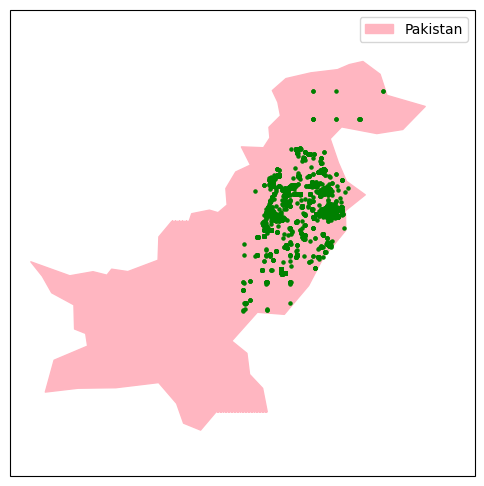

In [ ]:
# Convert the latitude and longitude columns to Point geometries
geometry = [Point(xy) for xy in zip(data['plong'], data['plat'])]

# Create a GeoDataFrame from the data
gdf = gpd.GeoDataFrame(data, crs="EPSG:4326", geometry=geometry)

# Load the world map data
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Extract the geometry of Pakistan
pakistan = world[(world.name == "Pakistan")]['geometry'].iloc[0]

# Filter out points that lie outside the boundary of Pakistan
gdf = gdf[gdf['geometry'].within(pakistan)]

plot_points_on_carree_map(gdf, pakistan)

In [ ]:
pip install --upgrade folium


In [ ]:
pip show folium

Name: folium
Version: 0.14.0
Summary: Make beautiful maps with Leaflet.js & Python
Home-page: https://github.com/python-visualization/folium
Author: Rob Story
Author-email: wrobstory@gmail.com
License: MIT
Location: /usr/local/lib/python3.10/dist-packages
Requires: branca, jinja2, numpy, requests
Required-by: datascience


In [ ]:
def generate_dark_random_colors(num_colors):
    colors = []
    while len(colors) < num_colors:
        # Generate random HSL color with fixed saturation and lightness (to get darker colors)
        h = random.randint(0, 360)
        s = 80  # Fixed saturation
        l = random.randint(30, 50)  # Restricted lightness for darker colors

        # Convert HSL to RGB
        r, g, b = colorsys.hls_to_rgb(h / 360, l / 100, s / 100)

        # Convert RGB to hex color code
        color = "#{:02x}{:02x}{:02x}".format(int(r * 255), int(g * 255), int(b * 255))

        if color not in colors:
            colors.append(color)

    # Randomly shuffle the colors to get unique and random colors
    random.shuffle(colors)
    return colors

def format_popup_content(row):
    popup_content = f"""
    <div style="font-family: Arial, sans-serif;">
        <h2 style="margin-bottom: 5px; text-align: center;">District: {row['district']}</h2>
        <table style="width: 100%;">
            <tr>
                <td style="font-weight: bold;">Diagnose:</td>
                <td>{row['provisionaldiagnose']}</td>
            </tr>
            <tr>
                <td style="font-weight: bold;">Age:</td>
                <td>{row['age']}</td>
            </tr>
            <tr>
                <td style="font-weight: bold;">Gender:</td>
                <td>{row['pgender']}</td>
            </tr>
            <!-- Add more information here if needed -->
        </table>
    </div>
    """
    return folium.Popup(folium.Html(popup_content, script=True), max_width=300)


def plot_points_on_folium_map(data, date_bin_by='year'):
    # Convert the latitude and longitude columns to Point geometries
    geometry = [Point(xy) for xy in zip(data['plong'], data['plat'])]

    # Create a GeoDataFrame from the data
    gdf = gpd.GeoDataFrame(data, crs="EPSG:4326", geometry=geometry)

    # Load the world map data
    world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
    # Extract the geometry of Pakistan
    pakistan = world[(world.name == "Pakistan")]['geometry'].iloc[0]


    # Filter out points that lie outside the boundary of Pakistan
    gdf = gdf[gdf['geometry'].within(pakistan)]

    # Create the Folium map centered around Pakistan
    m = folium.Map(location=[gdf['geometry'].centroid.y.mean(), gdf['geometry'].centroid.x.mean()], zoom_start=6, prefer_canvas=False, scrollWheelZoom=False)

    bordersStyle = {"color": 'green', 'weight': 2, 'fillOpacity': 0}

    bordersLayer = folium.GeoJson(
    data="/content/drive/MyDrive/Malaria/PakBorder/PAK_adm1.json",
    name="Borders",
    style_function=lambda x: bordersStyle)
    bordersLayer.add_to(m)

    # Create unique layers for each patient district and date_bin
    unique_districts = gdf['pdistrict'].unique()
    district_layers = {district: folium.FeatureGroup(name=district, show=False) for district in unique_districts}

    if date_bin_by == 'month':
      unique_date_bins = gdf['month_bin'].unique()
      d_bin = 'month_bin' #For iteration

    elif date_bin_by == 'year':
      unique_date_bins = gdf['year_bin'].unique()
      d_bin = 'year_bin' #For Iteration

    date_bin_layer = {date_bin: folium.FeatureGroup(name=str(date_bin), show=False) for date_bin in unique_date_bins}



    # Generate random dark colors for each unique patient district and date_bin
    district_colors = generate_dark_random_colors(len(unique_districts))
    date_bin_colors = generate_dark_random_colors(len(unique_date_bins))
    color_mapping_district = {district: color for district, color in zip(unique_districts, district_colors)}
    color_mapping_date_bin = {date_bin: color for date_bin, color in zip(unique_date_bins, date_bin_colors)}




    # Add the data points of each patient district and date_bin to the corresponding layer with the respective color
    for index, row in gdf.iterrows():
        lat, lon, district, province, dt_bin = row['plat'], row['plong'], row['pdistrict'], row['province'], row[d_bin]
        district_color = color_mapping_district[district]
        date_bin_color = color_mapping_date_bin[dt_bin]

        # popUpStr = 'Area - {0}<br>District - {1}<br>Province '.format(district, province)
        # iframe = folium.branca.element.IFrame(html=html, width=500, height=300)
        # popup = folium.Popup(iframe, max_width=2650, parse_html=True)
        # test = folium.Html('<b>nm<br>desc</b>', script=True) # i'm assuming this bit runs fine
        # iframe = branca.element.IFrame(html=test, width=350, height=150)
        # popup = folium.Popup(iframe, parse_html=True)

        popupt = f"lat: {lat}, long: {lon}"

        folium.Circle([lat, lon], radius=5, color=district_color, popup=popupt, opacity=1, fill_color=district_color).add_to(district_layers[district])

        # folium.CircleMarker([lat, lon], radius=4, color=date_bin_color, opacity=0.7, fill=False).add_to(date_bin_layer[dt_bin])


    # Add each patient district's layer to the map
    for district, layer in district_layers.items():
        layer.add_to(m)

    # Add each bin layer to the map
    for d_bin, layer in date_bin_layer.items():
        layer.add_to(m)

    # Add a LayerControl to the map to toggle the patient district and year_bin layers on/off
    folium.LayerControl(collapsed=False).add_to(m)

    # Add legends with small color dots overlaying the map
    for district, color in color_mapping_district.items():
        legend_html = f'<div style="display:inline-block; margin-right:10px; background-color:{color}; height:10px; width:10px;"></div>{district}'
        m.get_root().html.add_child(folium.Element(legend_html))

    # Add legends with small color dots overlaying the map
    for d_bin, color in color_mapping_date_bin.items():
        legend_html = f'<div style="display:inline-block; margin-right:10px; background-color:{color}; height:10px; width:10px;"></div>{d_bin}'
        m.get_root().html.add_child(folium.Element(legend_html))

    return gdf, m



In [ ]:
'''
    df : geodataframe
    map : plot points on folium map and show map
'''
df, map = plot_points_on_folium_map(data, date_bin_by='year')

<ipython-input-91-10ff805500b7>:54: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
<ipython-input-91-10ff805500b7>:63: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  m = folium.Map(location=[gdf['geometry'].centroid.y.mean(), gdf['geometry'].centroid.x.mean()], zoom_start=6, prefer_canvas=False, scrollWheelZoom=False)


In [ ]:
# df.to_csv('/content/drive/MyDrive/Malaria/pak_datapoints.csv', index=False, encoding='utf-8')

In [ ]:
df[df['pdistrict'] == 'Faisalabad']

,id,date,provisionaldiagnose,hospital,district,pdistrict,pgender,ptown,plat,plong,age,province,phasno,facility_type,address,year_bin,geometry
112,51761,2015-08-22,MALARIA (SUSPECTED),THQ Hospital Jhumra,Faisalabad,Faisalabad,male,Faisalabad,31.570290,73.201432,0.0,Punjab,2015,THQ,Faisalabad Faisalabad Punjab,2015,POINT (73.20143 31.57029)
113,51767,2015-08-22,MALARIA (SUSPECTED),THQ Hospital Jhumra,Faisalabad,Faisalabad,male,Faisalabad,31.570290,73.201432,0.0,Punjab,2015,THQ,Faisalabad Faisalabad Punjab,2015,POINT (73.20143 31.57029)
127,56588,2015-08-24,MALARIA (SUSPECTED),THQ Hospital Jhumra,Faisalabad,Faisalabad,male,Faisalabad,31.570290,73.201432,0.0,Punjab,2015,THQ,Faisalabad Faisalabad Punjab,2015,POINT (73.20143 31.57029)
146,63437,2015-08-26,MALARIA (SUSPECTED),THQ Hospital Jhumra,Faisalabad,Faisalabad,male,Faisalabad,31.570290,73.201432,0.0,Punjab,2015,THQ,Faisalabad Faisalabad Punjab,2015,POINT (73.20143 31.57029)
151,66379,2015-08-28,MALARIA (SUSPECTED),THQ Hospital Jhumra,Faisalabad,Faisalabad,male,Faisalabad,31.570290,73.201432,0.0,Punjab,2015,THQ,Faisalabad Faisalabad Punjab,2015,POINT (73.20143 31.57029)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17788,7126460,2018-05-30,"MALARIA (SUSPECTED), MEASLES (SUSPECTED), PERT...",THQ Hospital Samanduri,Faisalabad,Faisalabad,female,Faisalabad City,31.422056,73.092325,0.0,Punjab,2018,THQ,Faisalabad City Faisalabad Punjab,2018,POINT (73.09233 31.42206)
17789,7126458,2018-05-31,"MALARIA (SUSPECTED), MEASLES (SUSPECTED), PERT...",THQ Hospital Samanduri,Faisalabad,Faisalabad,female,Faisalabad City,31.422056,73.092325,0.0,Punjab,2018,THQ,Faisalabad City Faisalabad Punjab,2018,POINT (73.09233 31.42206)
17790,7126459,2018-05-30,"MALARIA (SUSPECTED), MEASLES (SUSPECTED), PERT...",THQ Hospital Samanduri,Faisalabad,Faisalabad,female,Faisalabad City,31.422056,73.092325,0.0,Punjab,2018,THQ,Faisalabad City Faisalabad Punjab,2018,POINT (73.09233 31.42206)
17791,7126455,2018-05-30,"MALARIA (SUSPECTED), MEASLES (SUSPECTED), PERT...",THQ Hospital Samanduri,Faisalabad,Faisalabad,female,Faisalabad City,31.422056,73.092325,0.0,Punjab,2018,THQ,Faisalabad City Faisalabad Punjab,2018,POINT (73.09233 31.42206)


In [ ]:
map

In [ ]:
def count_unique_in_column(data, column_name):
    """
    Counts occurrences of each unique value in column.

    Parameters:
        data (dataframe): Pandas dataframe.
        column_name (str): The name of the column containing information.

    Returns:
        dict: A dictionary containing the counts of each unique value in the column.
    """
    try:
        # Read the CSV file into a DataFrame

        # Check if the column exists in the DataFrame
        if column_name in data.columns:
            # Count occurrences of each unique value
            value_counts = data[column_name].value_counts().to_dict()
            return value_counts
        else:
            print(f"The column '{column_name}' is not present in the file.")
            return {}

    except Exception as e:
        print(f"Error occurred while processing the file: {e}")
        return {}

In [ ]:
dist = count_unique_in_column(df, 'pdistrict')
dist

{'Bhakkar': 7132,
 'Khushab': 2141,
 'Sheikhupura': 2121,
 'Faisalabad': 2080,
 'Mianwali': 509,
 'Jhelum': 445,
 'Nankana Sahib': 422,
 'Layyah': 345,
 'Sargodha': 285,
 'Lodhran': 231,
 'Mandi Bahauddin': 222,
 'Bahawalpur': 208,
 'Toba Tek Singh': 190,
 'Attock': 164,
 'Vehari': 105,
 'Chakwal': 100,
 'Okara': 93,
 'Dera Ghazi Khan': 93,
 'Rawalpindi': 71,
 'Bahawalnagar': 70,
 'Khanewal': 58,
 'Muzaffargarh': 48,
 'Multan': 35,
 'Gujranwala': 29,
 'Jhang': 27,
 'Chiniot': 27,
 'Rajanpur': 21,
 'Pakpattan': 18,
 'Rahim Yar Khan': 13,
 'Gujrat': 12,
 'Lahore': 8,
 'Hafizabad': 4,
 'Sialkot': 2,
 'Kasur': 1}

In [ ]:
def count_total_in_column(data, column_name):
    """
    counts the total number of unique non-NaN values in the specified column.

    Parameters:
        data (dataframe): data (dataframe): Pandas dataframe.
        column_name (str): The name of the column for which to count the values.

    Returns:
        int: The count of non-NaN values in the specified column, or None if the column is not found or has NaN values.
    """
    try:

        # Check if the column exists in the DataFrame
        if column_name in df.columns:
            # Check if the column has any NaN values
            if not data[column_name].isnull().any():
                # Count the non-NaN values in the column
                total_count = len(data[column_name].unique())
                return total_count
            else:
                print(f"The column '{column_name}' contains NaN values.")
                return None
        else:
            print(f"The column '{column_name}' is not present in the file.")
            return None

    except Exception as e:
        print(f"Error occurred while processing the file: {e}")
        return None

In [ ]:
count_total_in_column(df, 'pdistrict')

34

In [ ]:
def getAgerange(data):
  #Returns age range Min - Max age
  min_age = 0
  max_age = 0
  # Check if 'age' column exists in the data and handle missing values
  if 'age' in data.columns:
    filtered_age = data[data['age'] > 0]

  if not filtered_age.empty:
    min_age = filtered_age['age'].min()

    max_age = data['age'].max()

  return min_age, max_age


In [ ]:
min, max = getAgerange(df)
print("From ", min, "to ", max)

From  1.0 to  98.0
